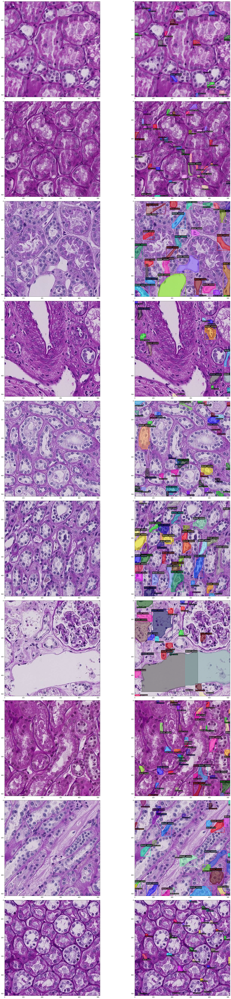

In [1]:
# !pip install pycocotools
# !pip install 'git+https://github.com/facebookresearch/detectron2.git'
import matplotlib.pyplot as plt
import cv2
import json
from pathlib import Path
from pycocotools import _mask
from pycocotools.coco import COCO
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.utils.visualizer import Visualizer, ColorMode

live_cell_imgs_dir = Path('/home/yiw/kg/input/train/')

register_coco_instances('sartorius_live_cell_train',{}, '/home/yiw/kg_yolo/pseduo_label.json', live_cell_imgs_dir)
live_cell_train_meta = MetadataCatalog.get('sartorius_live_cell_train')
live_cell_train_ds = DatasetCatalog.get('sartorius_live_cell_train')

idx = 10
cnt = 10
train_samples = live_cell_train_ds[idx:idx+cnt]
_,ax = plt.subplots(cnt, 2, figsize=(30, 10*cnt))
for idx, train_sample in enumerate(train_samples):
    img = cv2.imread(train_sample['file_name'])

    visualizer = Visualizer(img[:, :, ::-1], metadata=live_cell_train_meta)
    out = visualizer.draw_dataset_dict(train_sample)

    ax[idx][0].imshow(img)
    ax[idx][1].imshow(out.get_image()[:, :, ::-1])
plt.tight_layout()
plt.show()